# Documentation

OSMNX  
* Github: https://github.com/gboeing/osmnx
* Doc: https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=route#module-osmnx.graph

In [1]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import IFrame

%matplotlib inline

In [2]:
manhattan = 'Manhattan, New York City, New York, USA'
graph = ox.graph_from_place(manhattan, network_type='drive')

/Users/noah/opt/anaconda3/lib/python3.8/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))


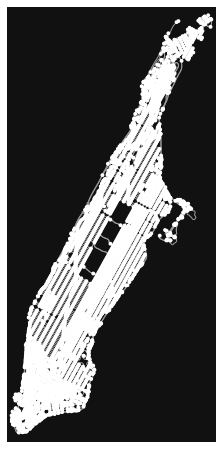

In [35]:
fig, ax = ox.plot_graph(graph)

# Display Graph as GeoPandas GeoDataFrames

In [38]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(graph)
gdf_nodes.head()

,y,x,highway,street_count,ref,geometry
osmid,,,,,,
42421728,40.798048,-73.960044,traffic_signals,3,NaN,POINT (-73.96004 40.79805)
42421731,40.798654,-73.961474,traffic_signals,4,NaN,POINT (-73.96147 40.79865)
42421737,40.799244,-73.962873,traffic_signals,4,NaN,POINT (-73.96287 40.79924)
42421741,40.800429,-73.965691,traffic_signals,4,NaN,POINT (-73.96569 40.80043)
42421745,40.801398,-73.967996,traffic_signals,4,NaN,POINT (-73.96800 40.80140)


In [39]:
gdf_edges.head()

osmid               name  \
u        v        key                                                       
42421728 42432736 0                          195743153  Central Park West   
         42435337 0                          195743153  Central Park West   
         42421731 0    [420625565, 420625573, 5668966]  West 106th Street   
42421731 42437916 0                            5671485   Manhattan Avenue   
         42432737 0                          195743186   Manhattan Avenue   

                           highway maxspeed  oneway   length  \
u        v        key                                          
42421728 42432736 0      secondary   25 mph   False   86.258   
         42435337 0      secondary   25 mph   False   85.342   
         42421731 0      secondary      NaN   False  138.033   
42421731 42437916 0    residential      NaN   False   86.149   
         42432737 0    residential      NaN   False   85.611   

                                                                geometry  \
u        v        key                                                      
42421728 42432736 0    LINESTRING (-73.96004 40.79805, -73.95996 40.7...   
         42435337 0    LINESTRING (-73.96004 40.79805, -73.96011 40.7...   
         42421731 0    LINESTRING (-73.96004 40.79805, -73.96017 40.7...   
42421731 42437916 0    LINESTRING (-73.96147 40.79865, -73.96197 40.7...   
         42432737 0    LINESTRING (-73.96147 40.79865, -73.96098 40.7...   

                       speed_kph  travel_time lanes  ref access bridge tunnel  \
u        v        key                                                           
42421728 42432736 0         40.2          7.7   NaN  NaN    NaN    NaN    NaN   
         42435337 0         40.2          7.6   NaN  NaN    NaN    NaN    NaN   
         42421731 0         38.9         12.8   NaN  NaN    NaN    NaN    NaN   
42421731 42437916 0         39.2          7.9   NaN  NaN    NaN    NaN    NaN   
         42432737 0         39.2          7.9   NaN  NaN    NaN    NaN    NaN   

                      width junction  
u        v        key                 
42421728 42432736 0     NaN      NaN  
         42435337 0     NaN      NaN  
         42421731 0     NaN      NaN  
42421731 42437916 0     NaN      NaN  
         42432737 0     NaN      NaN

# Add Speed Limits and Travel Time to Edges

In [34]:
graph = ox.add_edge_speeds(graph)
graph = ox.add_edge_travel_times(graph)
graph

# Save Graph to graphml file 

In [ ]:
ox.save_graphml(graph, filepath="./data/network.graphml")

# Plot Graph in Map

In [31]:
m1 = ox.plot_graph_folium(graph, fit_bounds=True, popup_attribute="name", weight=2, color="#333333")
filepath = "data/graph.html"
m1.save(filepath)
m1

# Plot shortest route between nodes in graph

{'y': 40.8140357, 'x': -73.9348357, 'street_count': 4}

In [32]:
#Print list of all nodes to determine start and end nodes or use network.graphml
#graph.nodes()

# use networkx to calculate the shortest path between two nodes
origin = 589927965
destination = 589928033
route = nx.shortest_path(graph, origin, destination, weight="travel_time")

# plot the route with folium
# like above, you can pass keyword args along to folium PolyLine to style the lines
m2 = ox.plot_route_folium(graph, route, route_map=m1, popup_attribute="length", weight=3)

for node in route:
    print(node, graph.nodes().get(node))
    node_x = graph.nodes().get(node).get('x')
    node_y= graph.nodes().get(node).get('y')
    #folium.Marker([node_x,node_y], popup = f"node").add_to(m2)

filepath = "data/route_graph.html"
#m2.save(filepath)
m2

589927965 {'y': 40.8140357, 'x': -73.9348357, 'street_count': 4}
7732243576 {'y': 40.8116473, 'x': -73.9348857, 'street_count': 3}
589928047 {'y': 40.8115152, 'x': -73.9349267, 'street_count': 3}
373850916 {'y': 40.8102102, 'x': -73.9354432, 'street_count': 3}
589927991 {'y': 40.809543, 'x': -73.9359356, 'highway': 'traffic_signals', 'street_count': 4}
589928037 {'y': 40.8089036, 'x': -73.9363976, 'highway': 'traffic_signals', 'street_count': 4}
589928035 {'y': 40.8088049, 'x': -73.9361336, 'highway': 'traffic_signals', 'street_count': 4}
371337145 {'y': 40.808181, 'x': -73.934691, 'street_count': 2}
42447210 {'y': 40.8075406, 'x': -73.9351045, 'street_count': 3}
42424757 {'y': 40.8069214, 'x': -73.9355603, 'highway': 'traffic_signals', 'street_count': 4}
589928033 {'y': 40.8075512, 'x': -73.9370575, 'highway': 'traffic_signals', 'street_count': 4}


# TODO: Compute Nearest Edge/Node For Coordinates

In [33]:
#osmnx.distance.nearest_edges(G, X, Y, interpolate=None, return_dist=True)
#osmnx.distance.nearest_nodes(G, X, Y, return_dist=True)
route

[589927965,
 7732243576,
 589928047,
 373850916,
 589927991,
 589928037,
 589928035,
 371337145,
 42447210,
 42424757,
 589928033]